In [1]:
import json
import pandas as pd
import numpy as np
import osgeo.gdal
import geopandas


import logging
logging.captureWarnings(True)


import matplotlib.pyplot as plt
import plotly.offline as ply
import plotly.graph_objs as plygo
import cufflinks as cf
ply.init_notebook_mode(connected=False)
cf.set_config_file(offline=True, world_readable=False, theme='white')


# CSV Files

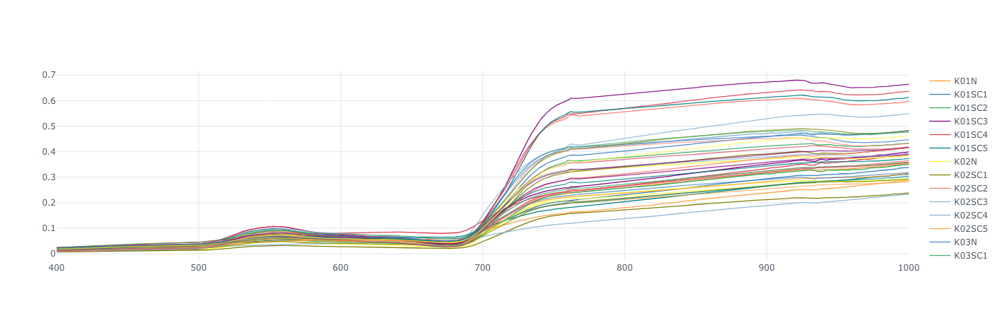

In [5]:
gt = pd.read_csv('../data/hyperspectral/field-reflectance/2017.09.09_Field Reflectance Air_Processed.csv')
gt.set_index('Sites', drop=True, inplace=True)
gt = gt.T

gt2 = pd.read_csv('../data/hyperspectral/field-reflectance/2017.08.20_Field Reflectance Air_Processed.csv')
gt2.set_index('Sites', drop=True, inplace=True)
gt2 = gt2.T


gt.iplot()
# gt2.iplot()


# Hyperspectral Image (GDAL)

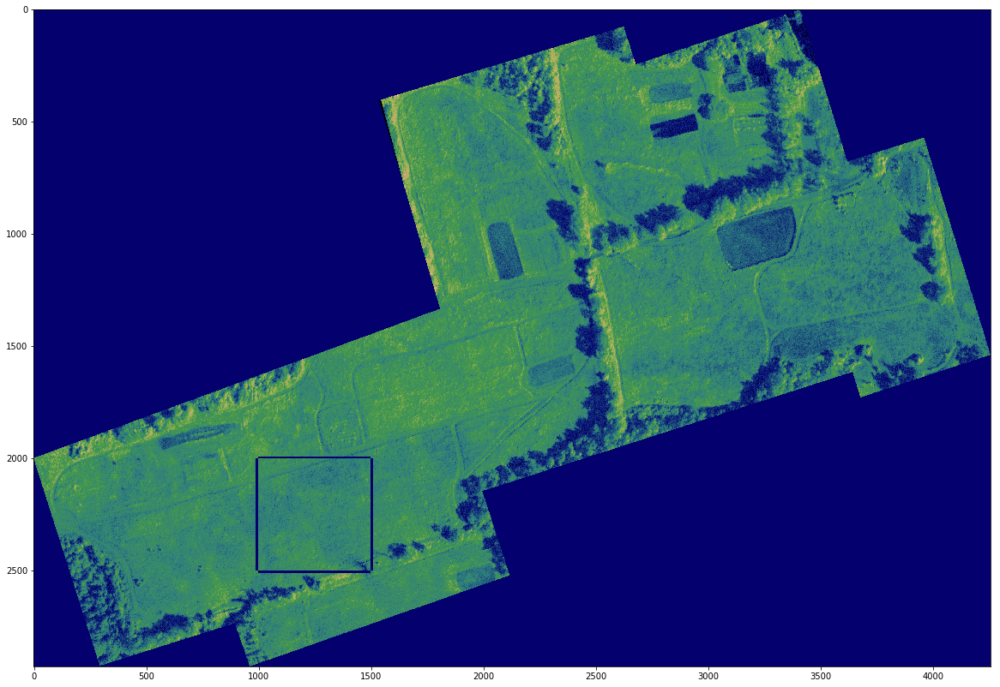

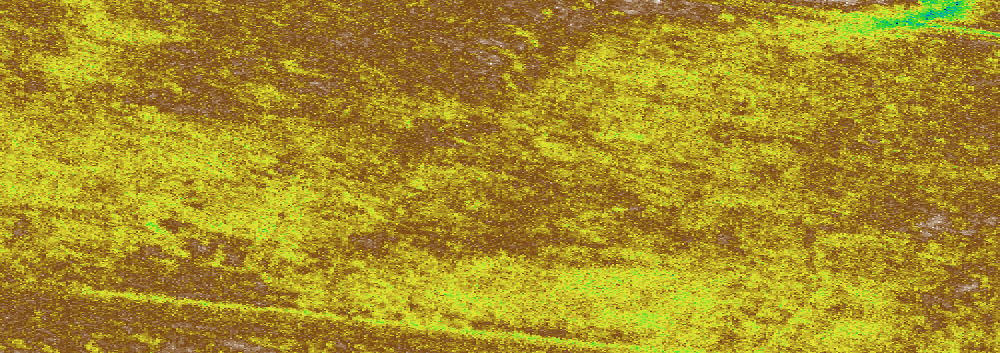

In [82]:
hsi = osgeo.gdal.Open('../data/hyperspectral/20170820_Reflectance_Resampled.tif')
hsi_array = hsi.ReadAsArray()
band = hsi.GetRasterBand(250).ReadAsArray()
_band = band[2000:2500, 1000:1500]
band[2000:2500, 1000-10:1000] = 0
band[2500:2500+10, 1000:1500] = 0
band[2000:2500, 1500:1500+10] = 0
band[2000-10:2000, 1000:1500] = 0
plt.figure(figsize = (20,20))
plt.imshow(band, cmap='gist_earth')
plt.show()

_band = band[2000:2500, 1000:1500]
df = pd.DataFrame(_band)

layout = plygo.Layout(
    autosize=False,
    width=500,
    height=500,
    margin=plygo.layout.Margin(
        l=0,
        r=0,
        b=0,
        t=0,
        pad=0
    )
)
data = [plygo.Heatmap( z=df.values.tolist(), colorscale='Earth', showscale=False)]
fig = plygo.Figure(data=data, layout=layout)

ply.iplot(fig)

In [81]:
shape = geopandas.read_file('../data/hyperspectral/ground-site-shapefile/20170820_GrassSitesKiran.shp')
shape['pixel'] = shape['geometry'].apply(lambda point: world2Pixel(geotransform, point.x, point.y))
shape.Covertype = shape.Covertype.str.replace(' ','')
shape.Covertype = shape.Covertype.str.split(',')
covertypes = pd.DataFrame(shape.Covertype.values.tolist())
del shape['Covertype']

covertypes.columns =  [f'Covertype']*len(covertypes.columns)
shape = shape.merge(covertypes, right_index=True, left_index=True, how='outer')
shape['Covertype'] = shape['Covertype'].apply(lambda x: x.str.split('-'), axis=1)
display(shape.head(10))

,name,Oldname,Xutm,Yutm,geometry,pixel,Covertype,Covertype,Covertype,Covertype
0,K02SC2,None,4.875982e+06,617173.243332,POINT (617173.2433317919 4875981.892127974),"(3536, 1296)","[Grape, 100]",None,None,None
1,K02SC1,None,4.875984e+06,617172.156219,POINT (617172.1562186017 4875983.594638234),"(3531, 1288)","[AwnlesBrome, 30]","[Grape, 35]","[RedFescue, 35]",None
2,K02SC4,None,4.875985e+06,617174.157393,POINT (617174.1573931372 4875985.063791923),"(3541, 1280)","[AwnlesBrome, 50]","[RedFescue, 50]",None,None
3,K02SC3,None,4.875983e+06,617174.853061,POINT (617174.8530605198 4875982.913625241),"(3544, 1291)","[AwnlesBrome, 20]","[Grape, 80]",None,None
4,K02SC5,None,4.875983e+06,617173.854680,POINT (617173.8546802911 4875983.462491875),"(3539, 1288)","[AwnlesBrome, 30]","[Grape, 70]",None,None
5,K02N,None,4.875979e+06,617176.017021,POINT (617176.0170214272 4875978.712297594),"(3550, 1312)","[AwnlesBrome, 35]","[RedFescue, 35]","[Grape, 20]","[Milkweek, 10]"
6,K03SC2,None,4.875965e+06,617045.301421,POINT (617045.301420728 4875965.065803409),"(2897, 1380)","[AwnlesBrome, 80]","[Milkweed, 20]","[Goldernrod, 10]",None
7,K03SC1,None,4.875967e+06,617045.388466,POINT (617045.3884657611 4875966.609325345),"(2897, 1373)","[AwnlesBrome, 90]","[Milkweed, 10]",None,None
8,K03SC4,None,4.875966e+06,617047.370723,POINT (617047.3707233504 4875966.471840205),"(2907, 1373)","[AwnlesBrome, 100]",None,None,None
9,K03SC3,None,4.875965e+06,617047.191431,POINT (617047.1914308384 4875964.895341892),"(2906, 1381)","[AwnlesBrome, 90]","[Milkweed, 10]",None,None


In [5]:
print("CSV File:", gt.shape)
print("CSV2 File:", gt2.shape)
print("Shape File:", shape.shape)
print("HSI File:", hsi.ReadAsArray().shape)

CSV File: (301, 40)
CSV2 File: (301, 40)
Shape File: (87, 9)
HSI File: (301, 2926, 4258)


In [58]:
crop = hsi.ReadAsArray(1000,2000,100,224)
crop.shape

(301, 224, 100)

In [11]:
hsi.RasterXSize, hsi.RasterYSize

(4258, 2926)

In [65]:
originX, pixelWidth, rotationX, originY, pixelHeight, rotationY = geotransform = hsi.GetGeoTransform()

def world2Pixel(geoMatrix, x, y):
        """
        Uses a gdal geomatrix (gdal.GetGeoTransform()) to calculate
        the pixel location of a geospatial coordinate

        copied from:
        https://pcjericks.github.io/py-gdalogr-cookbook/raster_layers.html
        """
        ulX = geoMatrix[0]
        ulY = geoMatrix[3]
        xDist = geoMatrix[1]
        yDist = geoMatrix[5]
        rtnX = geoMatrix[2]
        rtnY = geoMatrix[4]
        pixel = int((x - ulX) / xDist)
        line = -int((ulY - y) / yDist)        
        return (pixel, line)

In [74]:
x, y = world2Pixel(geotransform, 617172.156219, 4.875984e+06)
row=y
col=x
row, col

(1286, 3531)

In [75]:
a[:,row, col].shape

(301,)

In [3]:
shape = geopandas.read_file('../data/hyperspectral/ground-site-shapefile/20170820_GrassSitesKiran.shp')
shape

,name,Oldname,Xutm,Yutm,Covertype,geometry
0,K02SC2,None,4.875982e+06,617173.243332,Grape-100,POINT (617173.2433317919 4875981.892127974)
1,K02SC1,None,4.875984e+06,617172.156219,"Awnles Brome-30, Grape-35, Red Fescue-35",POINT (617172.1562186017 4875983.594638234)
2,K02SC4,None,4.875985e+06,617174.157393,"Awnles Brome-50, Red Fescue-50",POINT (617174.1573931372 4875985.063791923)
3,K02SC3,None,4.875983e+06,617174.853061,"Awnles Brome-20, Grape-80",POINT (617174.8530605198 4875982.913625241)
4,K02SC5,None,4.875983e+06,617173.854680,"Awnles Brome-30, Grape-70",POINT (617173.8546802911 4875983.462491875)
5,K02N,None,4.875979e+06,617176.017021,"Awnles Brome-35, Red Fescue-35, Grape-20, Milk...",POINT (617176.0170214272 4875978.712297594)
6,K03SC2,None,4.875965e+06,617045.301421,"Awnles Brome-80, Milkweed-20, Goldernrod-10",POINT (617045.301420728 4875965.065803409)
7,K03SC1,None,4.875967e+06,617045.388466,"Awnles Brome-90, Milkweed-10",POINT (617045.3884657611 4875966.609325345)
8,K03SC4,None,4.875966e+06,617047.370723,Awnles Brome-100,POINT (617047.3707233504 4875966.471840205)
9,K03SC3,None,4.875965e+06,617047.191431,"Awnles Brome-90, Milkweed-10",POINT (617047.1914308384 4875964.895341892)
